In [10]:
import pandas as pd
import numpy as np
from backtest import Engine
import matplotlib.pyplot as plt

Matplotlib is building the font cache; this may take a moment.


In [2]:
path = "/Users/sushrutkagde/Documents/QI CAP/2024-06-03 091500.000000000.csv"
# path = "/Users/sushrutkagde/Documents/QI CAP/BANKNIFTY.csv"

In [3]:
class SampleStrategy(Engine):
    def __init__(self, path):
        super().__init__(path)
        self.close_px = {}
        self.contracts = {}
        self.is_long = False
        self.is_short = False
        self.ma_20 = None
        self.ma_10 = None
        
        return
    
    def checkAllCondition(self):
        self.longCondition()
        self.ShortCondition()
        self.exit()
        return
    
    def Current_Bar(self):
        super().Current_Bar()

        flag = False

        for b in self.curr_bar:
            self.close_px.setdefault(b.contract_name,None) 
            
            if self.close_px[b.contract_name] is None:
                self.close_px[b.contract_name]=[]
                     
            if not np.isnan(b.close):
                self.close_px[b.contract_name].append(b.close)
                flag=True
                print(b.log_time,b.contract_name,b.close)

        if flag:
            self.checkAllCondition()
        return
    
    def longCondition(self):
        super().longCondition()
        if self.is_long:
            self.tradeExecution('NSE_BANKNIFTY_100_C_4640000',0)
            return
        # if not self.close_px['NSE_BANKNIFTY_100_C_4640000'][:-1] is None:
        #     print(self.close_px['NSE_BANKNIFTY_100_C_4640000'][:-1])
        self.is_long=True
        self.tradeExecution('NSE_BANKNIFTY_100_C_4640000',2)
        return
    
    def ShortCondition(self):
        super().ShortCondition()
        self.is_short = True
        if self.is_short :
            return
        self.tradeExecution('NSE_BANKNIFTY_100_C_4640000',-1)
        return
    
    def exit(self):
        super().exit()
        if not self.is_long and not self.is_short:
            return
        
        return
    
    # def Backtesting(self, start_date, end_date, config: dict):
    #     super().Backtesting(start_date, end_date, config)
    #     return
    

    


In [4]:
config = {
    'stock' : ['BANKNIFTY'],
    'exp_code' : ['0','100'],
}

In [6]:
strat = SampleStrategy(path)
start = '2024-06-03'

strat.Backtesting(start,start,config=config)


2024-06-03 091501.000000000 NSE_BANKNIFTY_0 5094902.5
2024-06-03 091501.000000000 NSE_BANKNIFTY_100_C_4640000 466250.0
2024-06-03 091501.000000000 NSE_BANKNIFTY_100_P_4640000 11025.0
2024-06-03 091501.000000000 NSE_BANKNIFTY_100_C_4650000 456000.0
2024-06-03 091501.000000000 NSE_BANKNIFTY_100_P_4650000 6577.5
2024-06-03 091501.000000000 NSE_BANKNIFTY_100_C_4660000 446750.0
2024-06-03 091501.000000000 NSE_BANKNIFTY_100_P_4660000 14817.5
2024-06-03 091501.000000000 NSE_BANKNIFTY_100_C_4670000 436000.0
2024-06-03 091501.000000000 NSE_BANKNIFTY_100_P_4670000 16292.5
2024-06-03 091501.000000000 NSE_BANKNIFTY_100_C_4680000 427250.0
2024-06-03 091501.000000000 NSE_BANKNIFTY_100_P_4680000 17155.0
2024-06-03 091501.000000000 NSE_BANKNIFTY_100_P_4690000 18507.5
2024-06-03 091501.000000000 NSE_BANKNIFTY_100_C_4700000 406500.0
2024-06-03 091501.000000000 NSE_BANKNIFTY_100_P_4700000 8230.0
2024-06-03 091501.000000000 NSE_BANKNIFTY_100_P_4710000 19300.0
2024-06-03 091501.000000000 NSE_BANKNIFTY_100_

<Axes: >

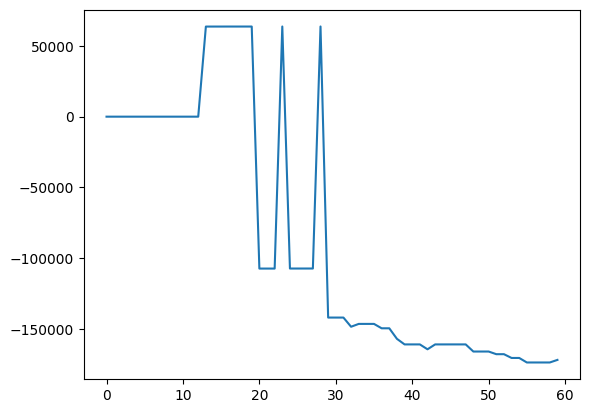

In [11]:
df = pd.read_csv('/Users/sushrutkagde/Documents/Backtesting Engine/2024-06-03_Traded_orders.csv')
df['pnl'].plot()